In [2]:
# !python -m spacy download en_core_web_sm

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px # is a high-level interface for creating various types of interactive plots with minimal code.
import plotly.graph_objects as go # is a lower-level interface that offers more control and customization over the appearance and behavior of your plots

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
df1 = pd.read_csv("/content/drive/MyDrive/Project/Stock_Market/stock_tweets.csv")

In [7]:
df1.head()

,Date,Tweet,Stock Name,Company Name
0,2022-09-29 23:41:16+00:00,Mainstream media has done an amazing job at br...,TSLA,"Tesla, Inc."
1,2022-09-29 23:24:43+00:00,Tesla delivery estimates are at around 364k fr...,TSLA,"Tesla, Inc."
2,2022-09-29 23:18:08+00:00,3/ Even if I include 63.0M unvested RSUs as of...,TSLA,"Tesla, Inc."
3,2022-09-29 22:40:07+00:00,@RealDanODowd @WholeMarsBlog @Tesla Hahaha why...,TSLA,"Tesla, Inc."
4,2022-09-29 22:27:05+00:00,"@RealDanODowd @Tesla Stop trying to kill kids,...",TSLA,"Tesla, Inc."


In [8]:
df1.tail()

,Date,Tweet,Stock Name,Company Name
80788,2021-10-07 17:11:57+00:00,Some of the fastest growing tech stocks on the...,XPEV,XPeng Inc.
80789,2021-10-04 17:05:59+00:00,"With earnings on the horizon, here is a quick ...",XPEV,XPeng Inc.
80790,2021-10-01 04:43:41+00:00,Our record delivery results are a testimony of...,XPEV,XPeng Inc.
80791,2021-10-01 00:03:32+00:00,"We delivered 10,412 Smart EVs in Sep 2021, rea...",XPEV,XPeng Inc.
80792,2021-09-30 10:22:52+00:00,Why can XPeng P5 deliver outstanding performan...,XPEV,XPeng Inc.


In [9]:
df1.shape

(80793, 4)

In [10]:
df1.columns

Index(['Date', 'Tweet', 'Stock Name', 'Company Name'], dtype='object')

In [11]:
df1.duplicated().sum()

0

In [12]:
df1.isnull().sum()

,0
Date,0
Tweet,0
Stock Name,0
Company Name,0


In [13]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 80793 entries, 0 to 80792
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Date          80793 non-null  object
 1   Tweet         80793 non-null  object
 2   Stock Name    80793 non-null  object
 3   Company Name  80793 non-null  object
dtypes: object(4)
memory usage: 2.5+ MB


In [14]:
df1.nunique()

,0
Date,64424
Tweet,64479
Stock Name,25
Company Name,25


In [15]:
df1['Stock Name'].unique()

array(['TSLA', 'MSFT', 'PG', 'META', 'AMZN', 'GOOG', 'AMD', 'AAPL',
       'NFLX', 'TSM', 'KO', 'F', 'COST', 'DIS', 'VZ', 'CRM', 'INTC', 'BA',
       'BX', 'NOC', 'PYPL', 'ENPH', 'NIO', 'ZS', 'XPEV'], dtype=object)

In [16]:
df1['Stock Name'].value_counts()

,count
Stock Name,
TSLA,37422
TSM,11034
AAPL,5056
AMZN,4089
MSFT,4089
PG,4089
NIO,3021
META,2751
AMD,2227


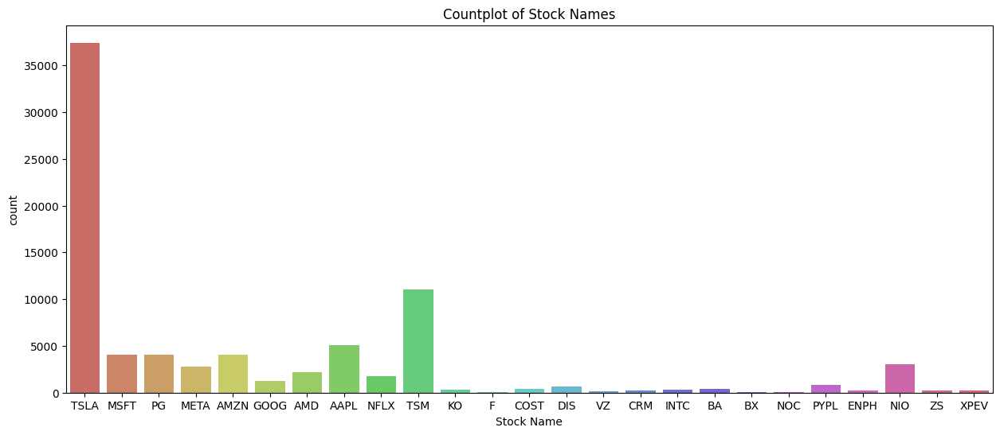

In [17]:
plt.figure(figsize=(15,6))
sns.countplot(x = 'Stock Name', data = df1, palette = 'hls')
plt.title('Countplot of Stock Names')
plt.show()

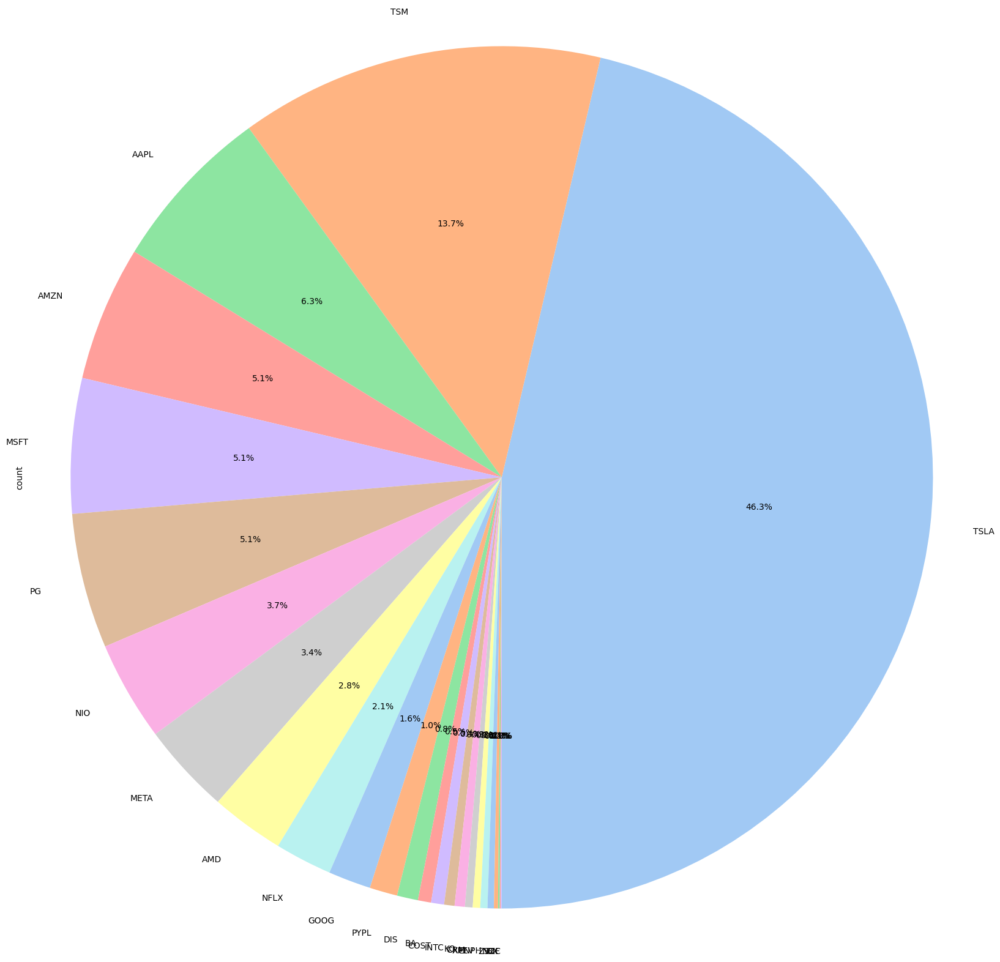

In [18]:
plt.figure(figsize=(20, 20))
df1['Stock Name'].value_counts().plot(kind='pie', autopct='%1.1f%%', startangle=-90, colors=sns.color_palette('pastel'))
plt.axis('equal')
plt.show()

In [19]:
fig = go.Figure(data=[go.Bar(x=df1['Stock Name'].value_counts().index, y=df1['Stock Name'].value_counts())])
fig.update_layout(title='Countplot for Stock Name', xaxis_title= 'Stock Name', yaxis_title="Count")
fig.show()

In [20]:
fig = px.pie(df1, names='Stock Name', title='Stock Name Distribution')
fig.update_layout(
    title='Stock Name Distribution',
    height=800,
    width=800
)
fig.show()

In [21]:
df1['Company Name'].unique()

array(['Tesla, Inc.', 'Microsoft Corporation', 'Procter & Gamble Company',
       'Meta Platforms, Inc.', 'Amazon.com, Inc.', 'Alphabet Inc.',
       'Advanced Micro Devices, Inc.', 'Apple Inc.', 'Netflix, Inc.',
       'Taiwan Semiconductor Manufacturing Company Limited',
       'The Coca-Cola Company', 'Ford Motor Company',
       'Costco Wholesale Corporation', 'The Walt Disney Company',
       'Verizon Communications Inc.', 'Salesforce, Inc.',
       'Intel Corporation', 'The Boeing Company', 'Blackstone Inc.',
       'Northrop Grumman Corporation', 'PayPal Holdings, Inc.',
       'Enphase Energy, Inc.', 'NIO Inc.', 'Zscaler, Inc.', 'XPeng Inc.'],
      dtype=object)

In [22]:
df1['Company Name'].value_counts()

,count
Company Name,
"Tesla, Inc.",37422
Taiwan Semiconductor Manufacturing Company Limited,11034
Apple Inc.,5056
"Amazon.com, Inc.",4089
Microsoft Corporation,4089
Procter & Gamble Company,4089
NIO Inc.,3021
"Meta Platforms, Inc.",2751
"Advanced Micro Devices, Inc.",2227


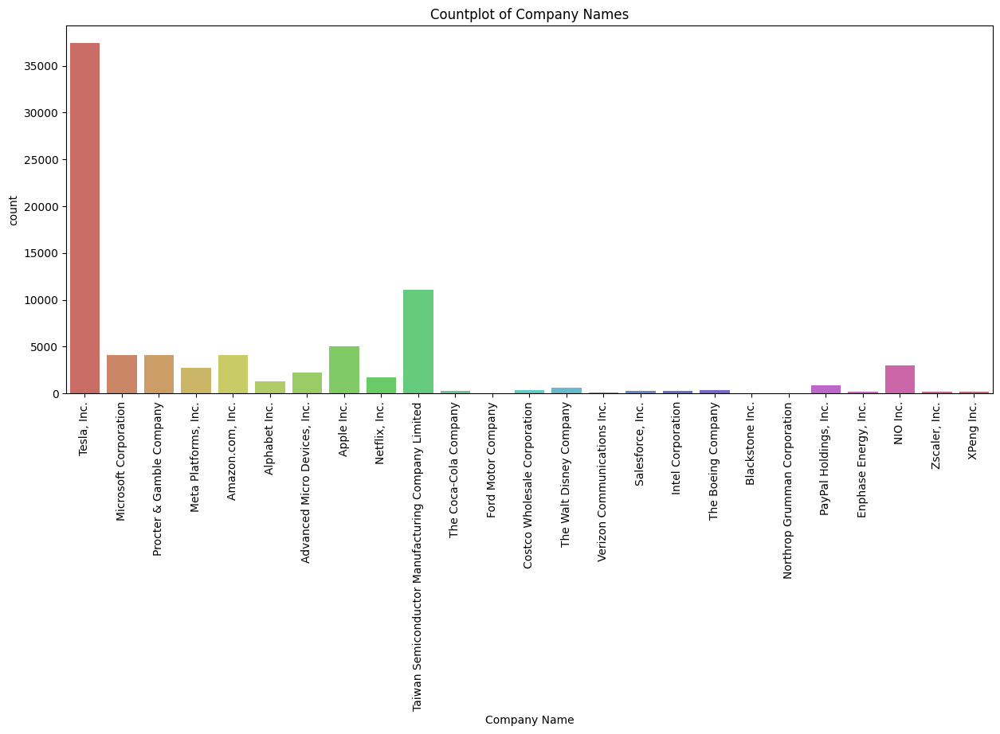

In [23]:
plt.figure(figsize=(15,6))
sns.countplot(x='Company Name', data = df1, palette = 'hls')
plt.xticks(rotation = 90)
plt.title('Countplot of Company Names')
plt.show()

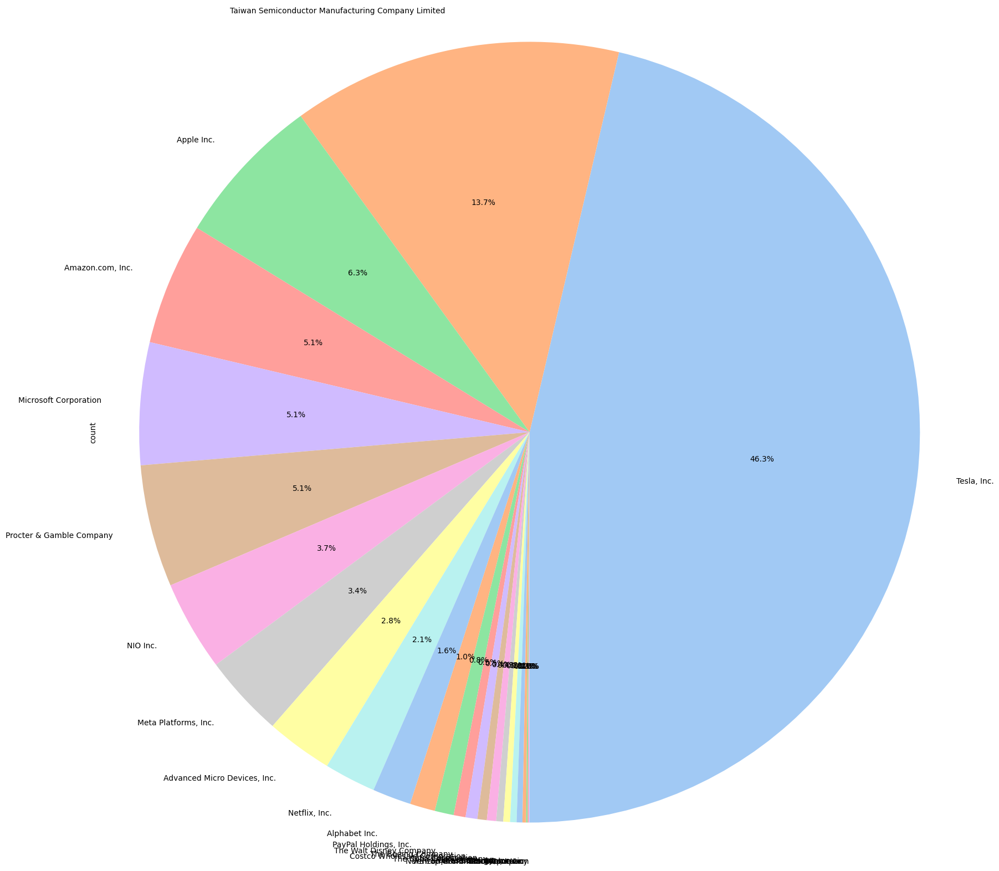

In [24]:
plt.figure(figsize=(20, 20))
df1['Company Name'].value_counts().plot(kind='pie', autopct='%1.1f%%', startangle=-90,
                                        colors=sns.color_palette('pastel'))
plt.axis('equal')
plt.show()

In [25]:
fig = go.Figure(data=[go.Bar(x=df1['Company Name'].value_counts().index, y=df1['Company Name'].value_counts())])
fig.update_layout(title='Countplot for Company Name', xaxis_title= 'Company Name',
                  yaxis_title="Count", height=800, width=800)
fig.show()

In [26]:
fig = px.pie(df1, names='Company Name', title='Company Name Distribution')
fig.update_layout(
    title='Company Name Distribution',
    height=800,
    width=800
)
fig.show()

In [27]:
df1['Date'] = pd.to_datetime(df1['Date'])

In [28]:
df11 = df1.copy()

In [29]:
df11

,Date,Tweet,Stock Name,Company Name
0,2022-09-29 23:41:16+00:00,Mainstream media has done an amazing job at br...,TSLA,"Tesla, Inc."
1,2022-09-29 23:24:43+00:00,Tesla delivery estimates are at around 364k fr...,TSLA,"Tesla, Inc."
2,2022-09-29 23:18:08+00:00,3/ Even if I include 63.0M unvested RSUs as of...,TSLA,"Tesla, Inc."
3,2022-09-29 22:40:07+00:00,@RealDanODowd @WholeMarsBlog @Tesla Hahaha why...,TSLA,"Tesla, Inc."
4,2022-09-29 22:27:05+00:00,"@RealDanODowd @Tesla Stop trying to kill kids,...",TSLA,"Tesla, Inc."
...,...,...,...,...
80788,2021-10-07 17:11:57+00:00,Some of the fastest growing tech stocks on the...,XPEV,XPeng Inc.
80789,2021-10-04 17:05:59+00:00,"With earnings on the horizon, here is a quick ...",XPEV,XPeng Inc.
80790,2021-10-01 04:43:41+00:00,Our record delivery results are a testimony of...,XPEV,XPeng Inc.
80791,2021-10-01 00:03:32+00:00,"We delivered 10,412 Smart EVs in Sep 2021, rea...",XPEV,XPeng Inc.


The format you provided, "2022-09-29 23:41:16+00:00," is in ISO 8601 date and time format with a time zone offset. Here's a breakdown of its components:

"2022" is the year.
"09" is the month (September).
"29" is the day of the month.
"23" is the hour in 24-hour format (in this case, 11:00 PM).
"41" is the minute.
"16" is the second.
"+00:00" represents the time zone offset, which in this case is UTC (Coordinated Universal Time), with no offset from UTC (indicating the time is in UTC).
So, the provided timestamp represents a date and time of September 29, 2022, at 11:41:16 PM (23:41:16) in the UTC time zone.

In [30]:
df11.set_index('Date', inplace=True)

In [31]:
start_date = df11.index.min()
end_date = df11.index.max()

In [32]:
print("Start Date of Stocks:", start_date)
print("End Date of Stocks:", end_date)

Start Date of Stocks: 2021-09-30 00:06:02+00:00
End Date of Stocks: 2022-09-29 23:41:16+00:00


In [33]:
week_delta = pd.Timedelta(days=7)
current_date = start_date

In [34]:
while current_date <= end_date:
    start_week = current_date
    end_week = current_date + week_delta
    current_week_data = df11[(df11.index >= start_week) & (df11.index < end_week)]
    weekly_counts = current_week_data.resample('D').size()
    fig = px.bar(weekly_counts, x=weekly_counts.index, y=weekly_counts.values,
                 labels={'x': 'Date', 'y': 'Number of Tweets'},
                 title=f'Tweets for Week {start_week.strftime("%Y-%m-%d")} to {end_week.strftime("%Y-%m-%d")}')
    fig.update_layout(xaxis_tickangle=-45)
    fig.show()
    current_date += week_delta

In [35]:
daily_counts = df11.resample('D').size()

In [36]:
fig = go.Figure()
fig.add_trace(go.Bar(x=daily_counts.index, y=daily_counts.values,
                     marker_color='skyblue'))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [37]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Stock Name'):
    weekly_data = source_data.resample('W').size()
    fig.add_trace(go.Scatter(x=weekly_data.index, y=weekly_data.values,
                            mode='lines', name=source_name))
fig.update_layout(title='Number of Tweets Week-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [38]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Stock Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='lines', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [39]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Company Name'):
    weekly_data = source_data.resample('W').size()
    fig.add_trace(go.Scatter(x=weekly_data.index, y=weekly_data.values,
                            mode='lines', name=source_name))
fig.update_layout(title='Number of Tweets Week-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [40]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Company Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='lines', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [41]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Stock Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='markers', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [42]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Company Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='markers', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [43]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Stock Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='lines + markers', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [44]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Company Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='lines + markers', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [45]:
df11

,Tweet,Stock Name,Company Name
Date,,,
2022-09-29 23:41:16+00:00,Mainstream media has done an amazing job at br...,TSLA,"Tesla, Inc."
2022-09-29 23:24:43+00:00,Tesla delivery estimates are at around 364k fr...,TSLA,"Tesla, Inc."
2022-09-29 23:18:08+00:00,3/ Even if I include 63.0M unvested RSUs as of...,TSLA,"Tesla, Inc."
2022-09-29 22:40:07+00:00,@RealDanODowd @WholeMarsBlog @Tesla Hahaha why...,TSLA,"Tesla, Inc."
2022-09-29 22:27:05+00:00,"@RealDanODowd @Tesla Stop trying to kill kids,...",TSLA,"Tesla, Inc."
...,...,...,...
2021-10-07 17:11:57+00:00,Some of the fastest growing tech stocks on the...,XPEV,XPeng Inc.
2021-10-04 17:05:59+00:00,"With earnings on the horizon, here is a quick ...",XPEV,XPeng Inc.
2021-10-01 04:43:41+00:00,Our record delivery results are a testimony of...,XPEV,XPeng Inc.


In [46]:
def clean_text(text):
    text = text.lower()
    return text.strip()

In [47]:
df1.Tweet = df1.Tweet.apply(lambda x: clean_text(x))

In [48]:
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [49]:
def remove_punctuation(text):
    punctuationfree="".join([i for i in text if i not in string.punctuation])
    return punctuationfree

In [50]:
df1.Tweet = df1.Tweet.apply(lambda x:remove_punctuation(x))

In [51]:
import re

In [52]:
def tokenization(text):
    tokens = re.split('W+',text)
    return tokens

In [53]:
df1.Tweet = df1.Tweet.apply(lambda x: tokenization(x))

In [54]:
import nltk
nltk.download('stopwords')
stopwords = nltk.corpus.stopwords.words('english')
stopwords[0:10]
['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're"]

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're"]

In [55]:
def remove_stopwords(text):
    output= " ".join(i for i in text if i not in stopwords)
    return output

In [56]:
df1.Tweet = df1.Tweet.apply(lambda x:remove_stopwords(x))

In [58]:
def clean_text(text):
    text = re.sub('\[.*\]','', text).strip()
    text = re.sub('\S*\d\S*\s*','', text).strip()
    return text.strip()

In [59]:
df1.Tweet = df1.Tweet.apply(lambda x: clean_text(x))

In [60]:
import spacy
nlp = spacy.load('en_core_web_sm')

In [61]:
stopwords = nlp.Defaults.stop_words
def lemmatizer(text):
    doc = nlp(text)
    sent = [token.lemma_ for token in doc if not token.text in set(stopwords)]
    return ' '.join(sent)

In [62]:
for i, tweet in enumerate(df1["Tweet"]):
    print(i, tweet)  # Debugging
    try:
        df1.loc[i, "Tweet"] = " ".join([lemmatizer(word) for word in word_tokenize(tweet)])
    except Exception as e:
        print(f"Error at index {i}: {e}")


Streaming output truncated to the last 5000 lines.
Error at index 79640: name 'word_tokenize' is not defined
79641 largest nio institutional short sellers via puts

susquehanna international group llp shares valued usd

citadel advisors llc shares valued usd
Error at index 79641: name 'word_tokenize' is not defined
79642 nio bounce off the extension of wave w which is usually bullish however before talking about lows potentially being in i would like nio to break above and this last one being the ma we   will see if we can get some strength into nio day on the
Error at index 79642: name 'word_tokenize' is not defined
79643 people who sold nio at will be buying back at makes complete sense 😆
Error at index 79643: name 'word_tokenize' is not defined
79644 nio buy low sell high these are some of the lowest levels of
Error at index 79644: name 'word_tokenize' is not defined
79645 join nios ganesh v iyer at the forbes cio next virtual event today at pm et as we look at key planning variable

In [63]:
#df1.Tweet =  df1.Tweet.apply(lambda x: lemmatizer(x))
import nltk
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

# Download necessary NLTK data files (if not already downloaded)
nltk.download('punkt')
nltk.download('wordnet')

lemmatizer = WordNetLemmatizer().lemmatize  # Ensure lemmatizer is callable

# Debugging approach with word_tokenize
for i, tweet in enumerate(df1["Tweet"]):
    print(i, tweet)  # Debugging step
    try:
        df1.loc[i, "Tweet"] = " ".join([lemmatizer(word) for word in word_tokenize(str(tweet))])  # Ensure text is a string
    except Exception as e:
        print(f"Error at index {i}: {e}")


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


Streaming output truncated to the last 5000 lines.
Error at index 80609: 
**********************************************************************
  Resource punkt_tab not found.
  Please use the NLTK Downloader to obtain the resource:

  >>> import nltk
  >>> nltk.download('punkt_tab')
  
  For more information see: https://www.nltk.org/data.html

  Attempted to load tokenizers/punkt_tab/english/

  Searched in:
    - '/root/nltk_data'
    - '/usr/nltk_data'
    - '/usr/share/nltk_data'
    - '/usr/lib/nltk_data'
    - '/usr/share/nltk_data'
    - '/usr/local/share/nltk_data'
    - '/usr/lib/nltk_data'
    - '/usr/local/lib/nltk_data'
**********************************************************************

80610 breaking chinas securities regulator issues new draft regulation hinting at positive surprise on audit issues
kweb nio xpev li
Error at index 80610: 
**********************************************************************
  Resource punkt_tab not found.
  Please use the NLTK Downl

In [64]:
def remove_urls(vTEXT):
    vTEXT = re.sub(r'(https|http)?:\/\/(\w|\.|\/|\?|\=|\&|\%)*\b', '', vTEXT, flags=re.MULTILINE)
    return(vTEXT)

In [65]:
df1.Tweet = df1.Tweet.apply(lambda x: remove_urls(x))

In [66]:
def remove_digits(text):
    clean_text = re.sub(r"\b[0-9]+\b\s*", "", text)
    return(text)

In [67]:
df1.Tweet = df1.Tweet.apply(lambda x: remove_digits(x))

In [68]:
def remove_digits1(sample_text):
    clean_text = " ".join([w for w in sample_text.split() if not w.isdigit()])
    return(clean_text)

In [69]:
df1.Tweet = df1.Tweet.apply(lambda x: remove_digits1(x))

In [70]:
def remove_emojis(data):
    emoji_pattern = re.compile("["
                               u"\U0001F600-\U0001F64F"
                               u"\U0001F300-\U0001F5FF"
                               u"\U0001F680-\U0001F6FF"
                               u"\U0001F1E0-\U0001F1FF"
                               "]+", flags=re.UNICODE)
    return re.sub(emoji_pattern, '', data)

In [71]:
df1.Tweet = df1.Tweet.apply(lambda x: remove_emojis(x))

In [72]:
df1

,Date,Tweet,Stock Name,Company Name
0,2022-09-29 23:41:16+00:00,mainstream media has done an amazing job at br...,TSLA,"Tesla, Inc."
1,2022-09-29 23:24:43+00:00,tesla delivery estimates are at around from th...,TSLA,"Tesla, Inc."
2,2022-09-29 23:18:08+00:00,even if i include unvested rsus as of addition...,TSLA,"Tesla, Inc."
3,2022-09-29 22:40:07+00:00,realdanodowd wholemarsblog tesla hahaha why ar...,TSLA,"Tesla, Inc."
4,2022-09-29 22:27:05+00:00,realdanodowd tesla stop trying to kill kids yo...,TSLA,"Tesla, Inc."
...,...,...,...,...
80788,2021-10-07 17:11:57+00:00,some of the fastest growing tech stocks on the...,XPEV,XPeng Inc.
80789,2021-10-04 17:05:59+00:00,with earnings on the horizon here is a quick s...,XPEV,XPeng Inc.
80790,2021-10-01 04:43:41+00:00,our record delivery results are a testimony of...,XPEV,XPeng Inc.
80791,2021-10-01 00:03:32+00:00,we delivered smart evs in sep reaching the mil...,XPEV,XPeng Inc.


In [73]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


True

In [74]:
def get_sentiment_label(text):
    sia = SentimentIntensityAnalyzer()
    sentiment_scores = sia.polarity_scores(text)

    if sentiment_scores['compound'] >= 0.05:
        return 'Positive'
    elif sentiment_scores['compound'] <= -0.05:
        return 'Negative'
    else:
        return 'Neutral'

In [77]:
!pip install swifter
import swifter
df1['sentiment'] = df1['Tweet'].swifter.apply(get_sentiment_label)


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 40.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for swifter: filename=swifter-1.4.0-py3-none-any.whl size=16507 sha256=1f1176463bc06c93e3c0915bd46082467c4ecfefd64af5685f1352ba7cc921ee
  Stored in directory: /root/.cache/pip/wheels/ef/7f/bd/9bed48f078f3ee1fa75e0b29b6e0335ce1cb03a38d3443b3a3
Successfully built swifter


Pandas Apply:   0%|          | 0/80793 [00:00<?, ?it/s]

In [78]:
df1

,Date,Tweet,Stock Name,Company Name,sentiment
0,2022-09-29 23:41:16+00:00,mainstream media has done an amazing job at br...,TSLA,"Tesla, Inc.",Positive
1,2022-09-29 23:24:43+00:00,tesla delivery estimates are at around from th...,TSLA,"Tesla, Inc.",Neutral
2,2022-09-29 23:18:08+00:00,even if i include unvested rsus as of addition...,TSLA,"Tesla, Inc.",Positive
3,2022-09-29 22:40:07+00:00,realdanodowd wholemarsblog tesla hahaha why ar...,TSLA,"Tesla, Inc.",Negative
4,2022-09-29 22:27:05+00:00,realdanodowd tesla stop trying to kill kids yo...,TSLA,"Tesla, Inc.",Negative
...,...,...,...,...,...
80788,2021-10-07 17:11:57+00:00,some of the fastest growing tech stocks on the...,XPEV,XPeng Inc.,Positive
80789,2021-10-04 17:05:59+00:00,with earnings on the horizon here is a quick s...,XPEV,XPeng Inc.,Positive
80790,2021-10-01 04:43:41+00:00,our record delivery results are a testimony of...,XPEV,XPeng Inc.,Positive
80791,2021-10-01 00:03:32+00:00,we delivered smart evs in sep reaching the mil...,XPEV,XPeng Inc.,Positive


In [79]:
# Save the DataFrame to a CSV file
df1.to_csv('stock_tweets_sentiments.csv', index=False)


In [80]:
df1.rename(columns={'sentiment': 'Sentiment'}, inplace=True)

In [81]:
df1['Sentiment'].unique()

array(['Positive', 'Neutral', 'Negative'], dtype=object)

In [82]:
df1["Sentiment"].value_counts()

,count
Sentiment,
Positive,40828
Neutral,23893
Negative,16072


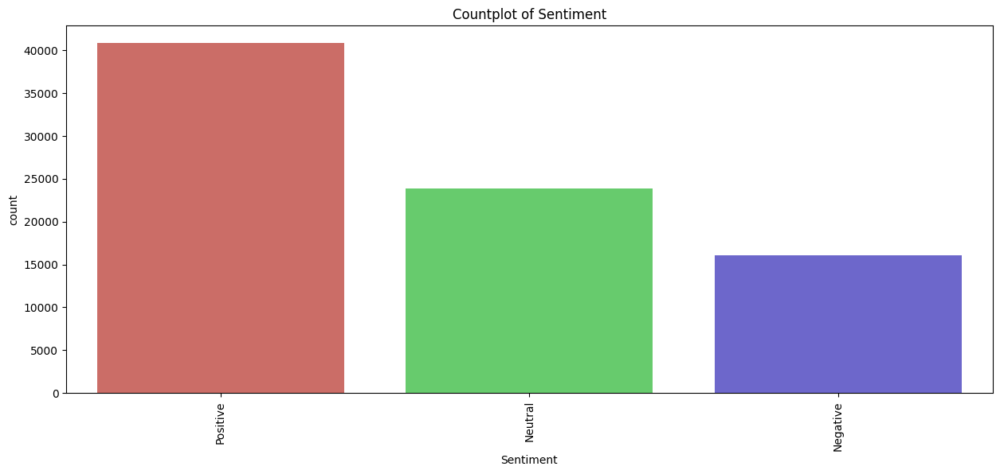

In [83]:
plt.figure(figsize=(15,6))
sns.countplot(x = 'Sentiment', data = df1, palette = 'hls')
plt.xticks(rotation = 90)
plt.title('Countplot of Sentiment')
plt.show()

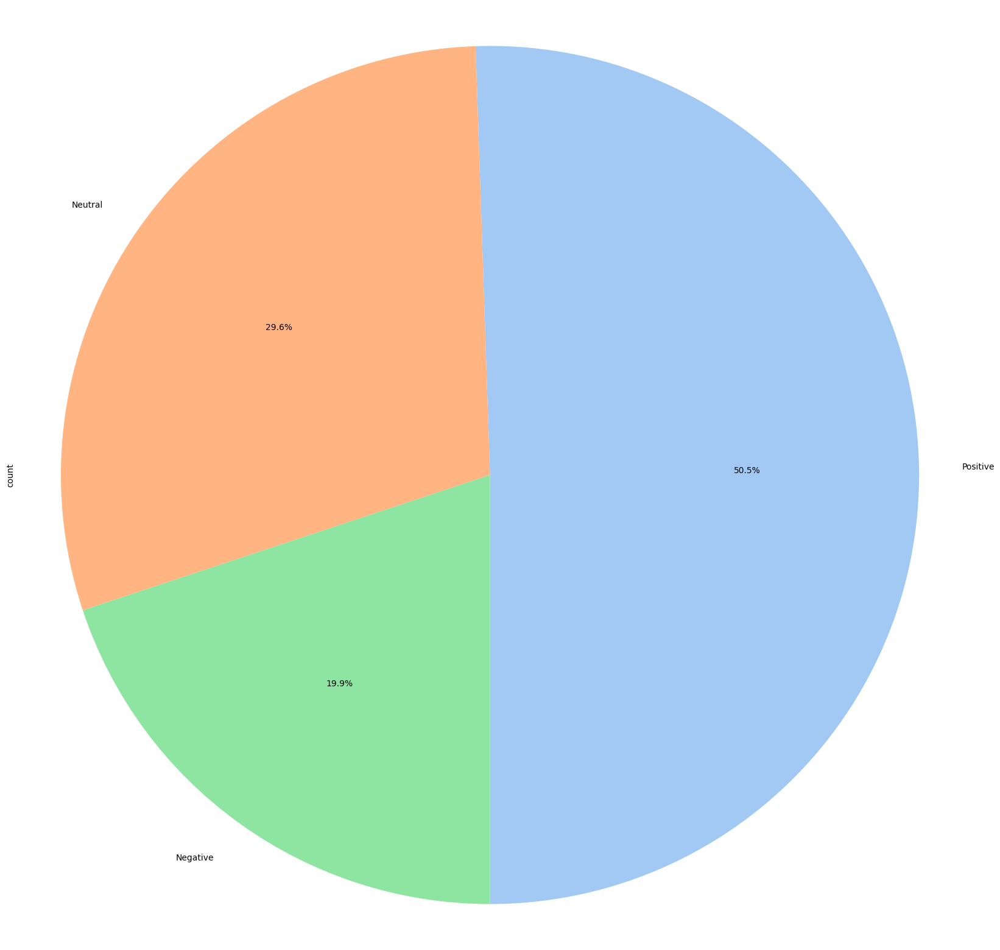

In [84]:
plt.figure(figsize=(20, 20))
df1['Sentiment'].value_counts().plot(kind='pie', autopct='%1.1f%%', startangle=-90,
                                        colors=sns.color_palette('pastel'))
plt.axis('equal')
plt.show()

In [85]:
fig = go.Figure(data=[go.Bar(x=df1['Sentiment'].value_counts().index, y=df1['Sentiment'].value_counts())])
fig.update_layout(title='Countplot for Sentiment', xaxis_title= 'Sentiment',
                  yaxis_title="Count", height=800, width=800)
fig.show()

In [86]:
fig = px.pie(df1, names='Sentiment', title='Sentiment Distribution')
fig.update_layout(
    title='Sentiment Distribution',
    height=800,
    width=800
)
fig.show()

In [87]:
!pip install wordcloud

import wordcloud

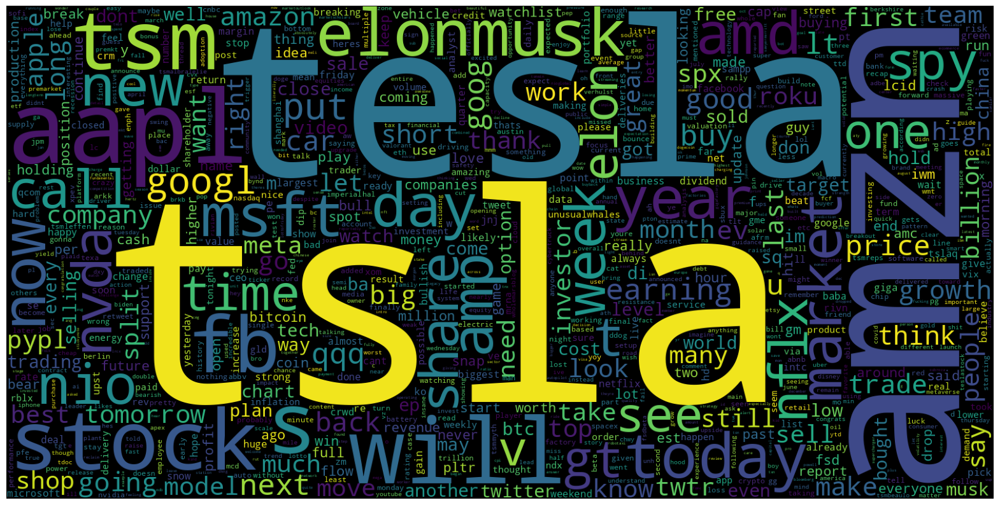

In [88]:
from wordcloud import WordCloud
data = df1.Tweet
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

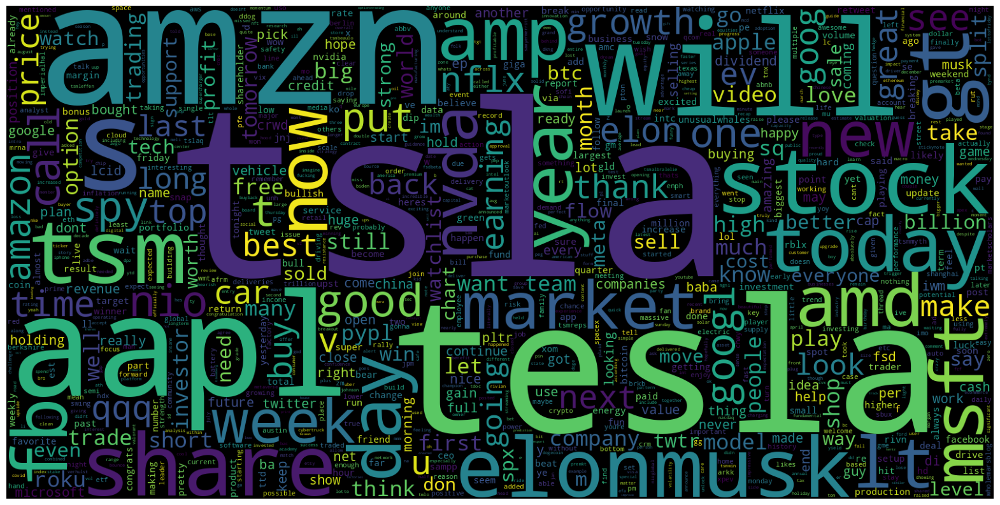

In [89]:
from wordcloud import WordCloud
data = df1[df1['Sentiment'] == "Positive"]['Tweet']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

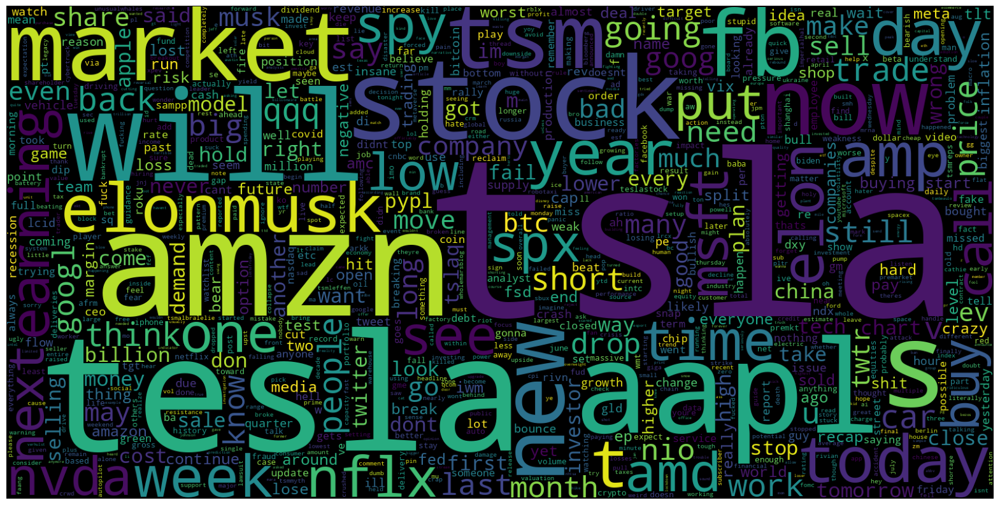

In [90]:
from wordcloud import WordCloud
data = df1[df1['Sentiment'] == "Negative"]['Tweet']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

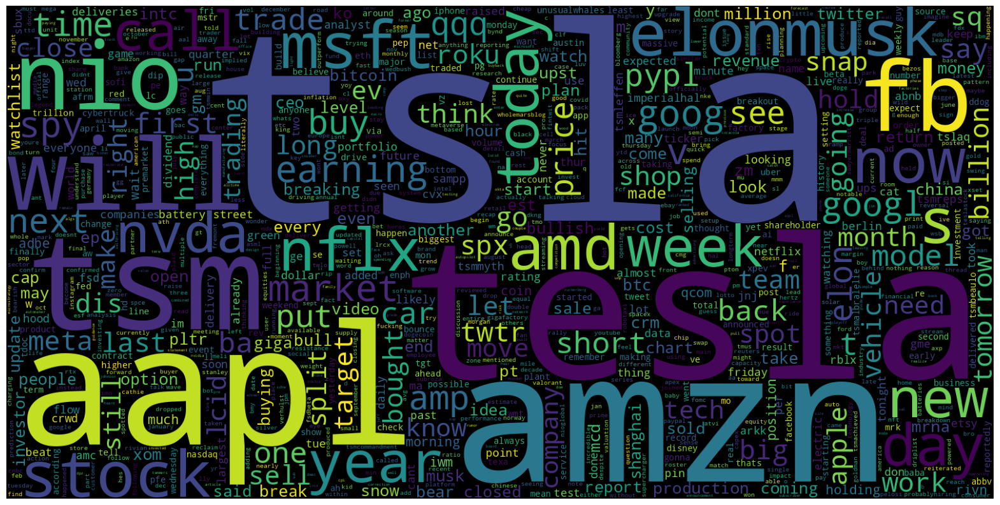

In [91]:
from wordcloud import WordCloud
data = df1[df1['Sentiment'] == "Neutral"]['Tweet']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

In [92]:
sentiment_counts_stock = df1.groupby(['Stock Name', 'Sentiment']).size().unstack(fill_value=0)

In [93]:
sentiment_counts_stock

Sentiment,Negative,Neutral,Positive
Stock Name,,,
AAPL,1076,1652,2328
AMD,323,584,1320
AMZN,821,1022,2246
BA,46,141,212
BX,5,12,33
COST,77,129,187
CRM,29,85,119
DIS,114,236,285
ENPH,25,44,147


In [94]:
sentiment_counts_company = df1.groupby(['Company Name', 'Sentiment']).size().unstack(fill_value=0)

In [95]:
sentiment_counts_company

Sentiment,Negative,Neutral,Positive
Company Name,,,
"Advanced Micro Devices, Inc.",323,584,1320
Alphabet Inc.,226,399,666
"Amazon.com, Inc.",821,1022,2246
Apple Inc.,1076,1652,2328
Blackstone Inc.,5,12,33
Costco Wholesale Corporation,77,129,187
"Enphase Energy, Inc.",25,44,147
Ford Motor Company,11,4,16
Intel Corporation,62,92,161


In [96]:
sentiment_counts_company['Total_Positive'] = sentiment_counts_company['Positive']
sentiment_counts_company['Total_Negative'] = sentiment_counts_company['Negative']
sentiment_counts_company['Total_Neutral'] = sentiment_counts_company['Neutral']

In [97]:
company_highest_positive = sentiment_counts_company['Total_Positive'].idxmax()
highest_positive_count = sentiment_counts_company['Total_Positive'].max()

company_highest_negative = sentiment_counts_company['Total_Negative'].idxmax()
highest_negative_count = sentiment_counts_company['Total_Negative'].max()

company_highest_neutral = sentiment_counts_company['Total_Neutral'].idxmax()
highest_neutral_count = sentiment_counts_company['Total_Neutral'].max()

company_lowest_positive = sentiment_counts_company['Total_Positive'].idxmin()
lowest_positive_count = sentiment_counts_company['Total_Positive'].min()

company_lowest_negative = sentiment_counts_company['Total_Negative'].idxmin()
lowest_negative_count = sentiment_counts_company['Total_Negative'].min()

company_lowest_neutral = sentiment_counts_company['Total_Neutral'].idxmin()
lowest_neutral_count = sentiment_counts_company['Total_Neutral'].min()

print(f"Company with Highest Positive Sentiment Count: {company_highest_positive} ({highest_positive_count} positive sentiments)")
print(f"Company with Highest Negative Sentiment Count: {company_highest_negative} ({highest_negative_count} negative sentiments)")
print(f"Company with Highest Neutral Sentiment Count: {company_highest_neutral} ({highest_neutral_count} neutral sentiments)")

print(f"Company with Lowest Positive Sentiment Count: {company_lowest_positive} ({lowest_positive_count} positive sentiments)")
print(f"Company with Lowest Negative Sentiment Count: {company_lowest_negative} ({lowest_negative_count} negative sentiments)")
print(f"Company with Lowest Neutral Sentiment Count: {company_lowest_neutral} ({lowest_neutral_count} neutral sentiments)")

Company with Highest Positive Sentiment Count: Tesla, Inc. (18495 positive sentiments)
Company with Highest Negative Sentiment Count: Tesla, Inc. (7974 negative sentiments)
Company with Highest Neutral Sentiment Count: Tesla, Inc. (10953 neutral sentiments)
Company with Lowest Positive Sentiment Count: Ford Motor Company (16 positive sentiments)
Company with Lowest Negative Sentiment Count: Blackstone Inc. (5 negative sentiments)
Company with Lowest Neutral Sentiment Count: Ford Motor Company (4 neutral sentiments)


In [126]:
# Save df1 as a CSV file
df1.to_csv("df1_adding_sentiment.csv", index=False)

# Download the file in Google Colab
from google.colab import files
files.download("df1_adding_sentiment.csv")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

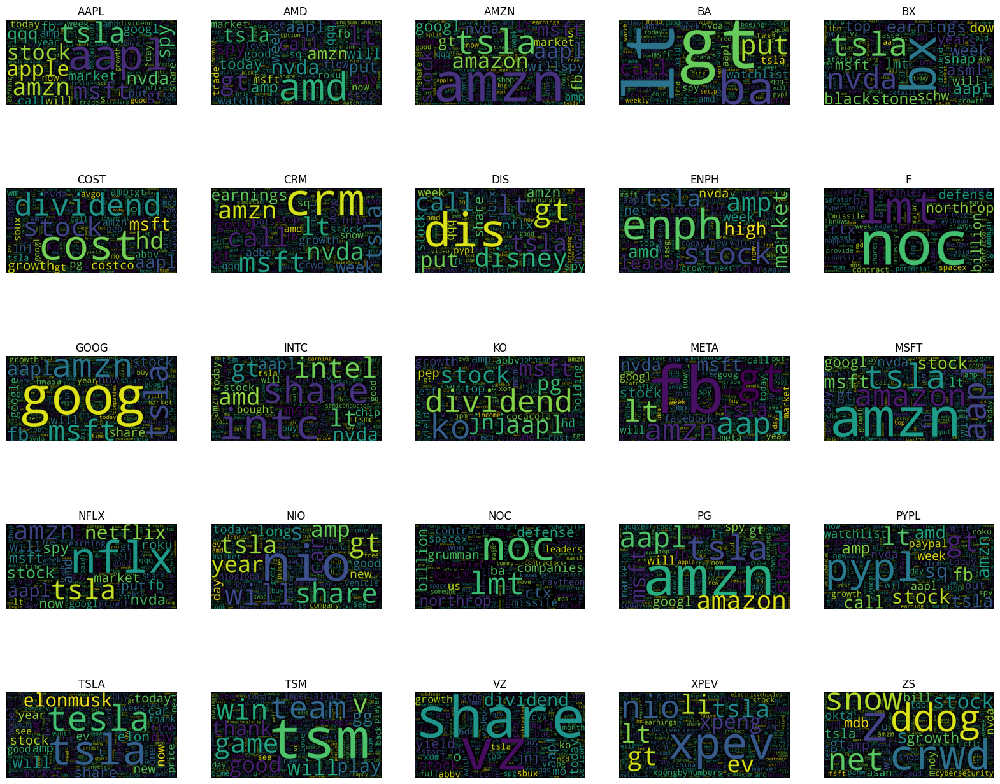

In [98]:
positive_data = df1[df1['Sentiment'] == "Positive"]

grouped_data = positive_data.groupby('Stock Name')

num_plots = min(len(grouped_data), 25)
rows, cols = (num_plots // 5) + 1, min(num_plots, 5)

plt.figure(figsize=(20, 20))
for i, (stock_name, data) in enumerate(grouped_data):
    wc = WordCloud(max_words=1000, width=1600, height=800, collocations=False).generate(" ".join(data['Tweet']))
    plt.subplot(rows, cols, i + 1)
    plt.imshow(wc, interpolation='bilinear')
    plt.title(stock_name)
    plt.axis('off')

plt.show()

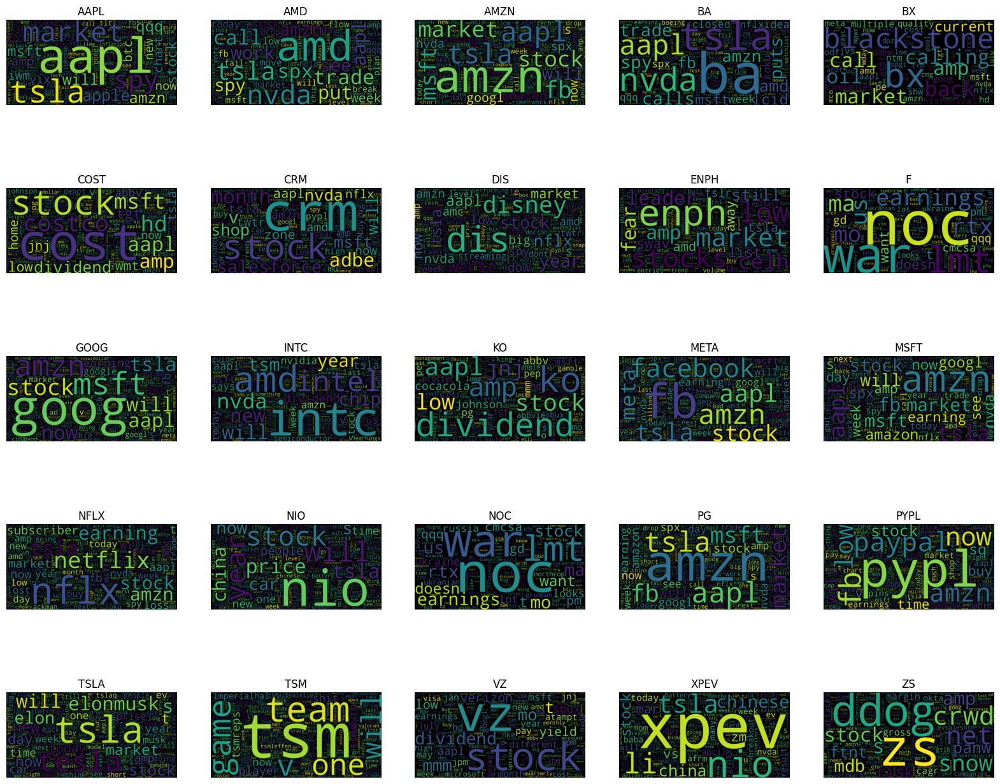

In [99]:
negative_data = df1[df1['Sentiment'] == "Negative"]

grouped_data = negative_data.groupby('Stock Name')

num_plots = min(len(grouped_data), 25)
rows, cols = (num_plots // 5) + 1, min(num_plots, 5)

plt.figure(figsize=(20, 20))
for i, (stock_name, data) in enumerate(grouped_data):
    wc = WordCloud(max_words=1000, width=1600, height=800, collocations=False).generate(" ".join(data['Tweet']))
    plt.subplot(rows, cols, i + 1)
    plt.imshow(wc, interpolation='bilinear')
    plt.title(stock_name)
    plt.axis('off')

plt.show()

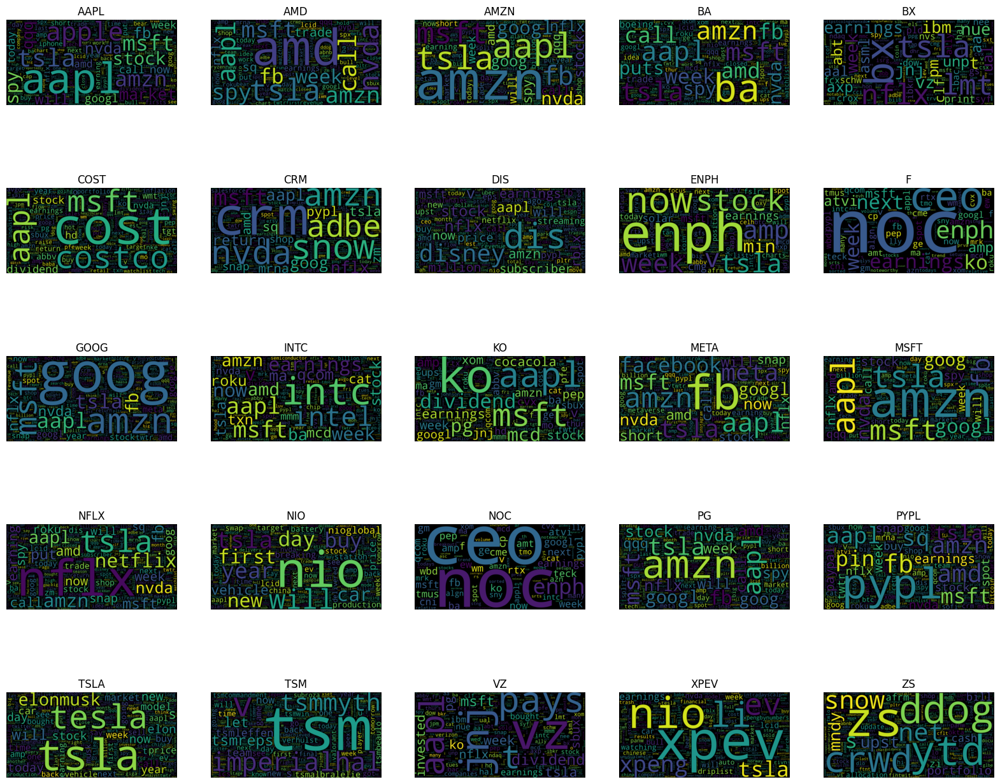

In [113]:
neutral_data = df1[df1['Sentiment'] == "Neutral"]

grouped_data = neutral_data.groupby('Stock Name')

num_plots = min(len(grouped_data), 25)
rows, cols = (num_plots // 5) + 1, min(num_plots, 5)

plt.figure(figsize=(20, 20))
for i, (stock_name, data) in enumerate(grouped_data):
    wc = WordCloud(max_words=1000, width=1600, height=800, collocations=False).generate(" ".join(data['Tweet']))
    plt.subplot(rows, cols, i + 1)
    plt.imshow(wc, interpolation='bilinear')
    plt.title(stock_name)
    plt.axis('off')

plt.show()

In [114]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [115]:
tf1=TfidfVectorizer()
data_vec=tf1.fit_transform(df1['Tweet'])

In [116]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df1['Sentiment_Label'] = label_encoder.fit_transform(df1['Sentiment'])

In [117]:
y=df1['Sentiment_Label'].values

In [118]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

In [119]:
X_train,X_test,y_train,y_test=train_test_split(data_vec,y,test_size=0.2,stratify = y, random_state=42)

In [120]:
!pip install imbalanced-learn
from imblearn.over_sampling import SMOTE

In [121]:
smote = SMOTE(random_state=42)
X_balanced, y_balanced = smote.fit_resample(X_train, y_train)

In [122]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [123]:
dt = DecisionTreeClassifier()
rf = RandomForestClassifier()

In [124]:
models = [dt, rf]

accuracies = []

for model in models:
    print('Results for the model:', model.__class__.__name__)
    model.fit(X_balanced, y_balanced)
    y_pred = model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    print('Accuracy:', accuracy)

    cm = confusion_matrix(y_test, y_pred)
    print('Confusion Matrix:\n', cm)

    report = classification_report(y_test, y_pred)
    print('Classification Report:\n', report)

    print('\n')

    accuracies.append(accuracy)

print('List of Accuracies:', accuracies)

Results for the model: DecisionTreeClassifier
Accuracy: 0.7491800235163067
Confusion Matrix:
 [[1899  523  792]
 [ 342 3780  657]
 [ 844  895 6427]]
Classification Report:
               precision    recall  f1-score   support

           0       0.62      0.59      0.60      3214
           1       0.73      0.79      0.76      4779
           2       0.82      0.79      0.80      8166

    accuracy                           0.75     16159
   macro avg       0.72      0.72      0.72     16159
weighted avg       0.75      0.75      0.75     16159



Results for the model: RandomForestClassifier
Accuracy: 0.81434494708831
Confusion Matrix:
 [[1873  541  800]
 [ 115 4149  515]
 [ 345  684 7137]]
Classification Report:
               precision    recall  f1-score   support

           0       0.80      0.58      0.68      3214
           1       0.77      0.87      0.82      4779
           2       0.84      0.87      0.86      8166

    accuracy                           0.81     16159
 

In [125]:
model_names = ['DecisionTree', 'RandomForest']
fig = go.Figure(data=go.Bar(x=model_names, y=accuracies))
fig.update_layout(title='Model Accuracies',
                  xaxis_title='Model',
                  yaxis_title='Accuracy',
                  yaxis_tickformat='.2%',
                  yaxis_range=[0, 1],
                  xaxis_tickangle=0)
fig.show()